In [73]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.figure_factory as ff
import seaborn as sns
%matplotlib inline

In [74]:
url = 'https://data.chhs.ca.gov/api/3/action/datastore_search'

In [75]:
params = {
    'resource_id': '59942195-7c44-40d3-93bb-48adc5809bd9',
    'limit': 1904  # Set limit to the total number of entries
}

In [76]:
response = requests.get(url, params=params)

In [77]:
data = response.json() 

In [78]:
records = data['result']['records']

In [79]:
df = pd.DataFrame(records)

In [80]:
df.head()

,_id,oshpd_id9,FacilityName,MDC_DESC,DXPatCount,count,COUNTY_NAME,PrimaryCareShortageArea,MentalHealthShortageArea,system
0,1,106010735,Alameda Hospital,"Infectious & Parasitic Diseases, Systemic or U...",416,1,Alameda,No,No,Alameda Health System
1,2,106010735,Alameda Hospital,Diseases & Disorders of the Respiratory System,296,2,Alameda,No,No,Alameda Health System
2,3,106010735,Alameda Hospital,Diseases & Disorders of the Nervous System,283,3,Alameda,No,No,Alameda Health System
3,4,106010735,Alameda Hospital,Diseases & Disorders of the Circulatory System,257,4,Alameda,No,No,Alameda Health System
4,5,106010735,Alameda Hospital,Diseases & Disorders of the Musculoskeletal Sy...,214,5,Alameda,No,No,Alameda Health System


In [81]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1904 entries, 0 to 1903
Data columns (total 10 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   _id                       1904 non-null   int64 
 1   oshpd_id9                 1904 non-null   object
 2   FacilityName              1904 non-null   object
 3   MDC_DESC                  1904 non-null   object
 4   DXPatCount                1904 non-null   object
 5   count                     1904 non-null   object
 6   COUNTY_NAME               1904 non-null   object
 7   PrimaryCareShortageArea   1904 non-null   object
 8   MentalHealthShortageArea  1904 non-null   object
 9   system                    1904 non-null   object
dtypes: int64(1), object(9)
memory usage: 148.9+ KB


In [82]:
df.isnull().sum()

_id                         0
oshpd_id9                   0
FacilityName                0
MDC_DESC                    0
DXPatCount                  0
count                       0
COUNTY_NAME                 0
PrimaryCareShortageArea     0
MentalHealthShortageArea    0
system                      0
dtype: int64

In [83]:
df.set_index('_id', inplace=True)

In [84]:
df[['DXPatCount']] = df[['DXPatCount']].apply(pd.to_numeric)

In [85]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1904 entries, 1 to 1904
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   oshpd_id9                 1904 non-null   object
 1   FacilityName              1904 non-null   object
 2   MDC_DESC                  1904 non-null   object
 3   DXPatCount                1904 non-null   int64 
 4   count                     1904 non-null   object
 5   COUNTY_NAME               1904 non-null   object
 6   PrimaryCareShortageArea   1904 non-null   object
 7   MentalHealthShortageArea  1904 non-null   object
 8   system                    1904 non-null   object
dtypes: int64(1), object(8)
memory usage: 148.8+ KB


In [86]:
df['FacilityName'].value_counts()

FacilityName
Adventist Health and Rideout                            5
Alameda Hospital                                        5
Alta Bates Summit Medical Center – Alta Bates Campus    5
UC San Francisco Benioff Children's Hospital Oakland    5
Sutter Davis Hospital                                   5
                                                       ..
Jerold Phelps Community Hospital                        1
Exodus PHF Fresno                                       1
Sutter-Yuba PHF                                         1
Stabler Lane Behavioral Health                          1
North Valley Behavioral Health                          1
Name: count, Length: 442, dtype: int64

In [87]:
df['MDC_DESC'].value_counts()

MDC_DESC
Diseases & Disorders of the Circulatory System                                267
Diseases & Disorders of the Respiratory System                                264
Infectious & Parasitic Diseases, Systemic or Unspecified Sites                260
Pregnancy, Childbirth & the Puerperium                                        209
Newborns & Other Neonates with Conditions Originating in Perinatal Period     191
Diseases & Disorders of the Digestive System                                  188
Diseases & Disorders of the Musculoskeletal System & Connective Tissue        141
Diseases & Disorders of the Nervous System                                    113
Mental Diseases & Disorders                                                   110
Alcohol/Drug Use & Alcohol/Drug Induced Organic Mental Disorders               42
Diseases & Disorders of the Kidney & Urinary Tract                             30
Factors Influencing Health Status & Other Contacts with Health Services        22
Endocri

In [88]:
df['system'].value_counts()

system
N/A                                  664
Kaiser Foundation Hospitals          157
Dignity Health                       150
Sutter Health                        120
Providence St. Joseph Health          88
Adventist Health Systems              81
Prime Healthcare Services             71
Tenet Healthcare Corporation          67
Kindred Healthcare, Inc.              57
University of California              35
KPC Healthcare, Inc.                  35
AHMC Healthcare, Inc.                 32
Vibra Healthcare                      30
Sharp Healthcare                      27
Verity Health System                  26
Alta Hospitals System                 26
Universal Health Services, Inc.       25
HCA Healthcare Corporation            25
Scripps Health                        20
County of Los Angeles                 20
MemorialCare                          20
Avanti Hospitals                      20
Loma Linda University                 17
Cedars-Sinai Health System            15
Universit

In [89]:
df[df['system'] == 'N/A']['FacilityName'].unique()

array(["UC San Francisco Benioff Children's Hospital Oakland",
       'St. Rose Hospital', 'Washington Hospital – Fremont',
       'Stanford Health Care Tri-Valley', 'Orchard Hospital',
       'Oroville Hospital', 'Enloe Medical Center– Esplanade',
       'Butte County Mental Health Services',
       'Contra Costa Regional Medical Center', 'Barton Memorial Hospital',
       'Marshall Medical Center', 'Clovis Community Medical Center',
       'Coalinga Regional Medical Center',
       'Community Regional Medical Center – Fresno',
       'Saint Agnes Medical Center', 'Fresno Surgical Hospital',
       'Exodus PHF Fresno', 'Central Star PHF', 'Glenn Medical Center',
       'Mad River Community Hospital', 'Jerold Phelps Community Hospital',
       'Sempervirens PHF', 'El Centro Regional Medical Center',
       'Pioneers Memorial Healthcare District', 'Northern Inyo Hospital',
       'Southern Inyo Hospital', 'Adventist Health Delano',
       'Kern Medical Center', 'Kern Valley Healthcare D

In [90]:
df['PrimaryCareShortageArea'].value_counts()

PrimaryCareShortageArea
No     1390
Yes     514
Name: count, dtype: int64

In [91]:
df['MentalHealthShortageArea'].value_counts()

MentalHealthShortageArea
No     1185
Yes     719
Name: count, dtype: int64

In [92]:
df['COUNTY_NAME'].value_counts()

COUNTY_NAME
Los Angeles        468
Orange             143
San Diego          115
San Bernardino     107
Riverside           95
Alameda             74
Kern                59
Sacramento          58
San Francisco       56
Santa Clara         54
San Joaquin         39
Fresno              39
Contra Costa        37
Sonoma              37
Ventura             37
Stanislaus          33
San Mateo           31
Santa Barbara       26
Shasta              24
Solano              22
San Luis Obispo     21
Marin               20
Monterey            20
Humboldt            18
Butte               17
Placer              16
Santa Cruz          16
Tulare              15
Mendocino           15
Plumas              11
El Dorado           11
Merced              11
Yolo                10
Siskiyou            10
Lake                10
Madera              10
Imperial            10
Napa                10
Nevada              10
Sutter               7
Tehama               6
Inyo                 6
Modoc                5

In [93]:
df['COUNTY_NAME'].nunique()

56

In [94]:
df[df['system'] == 'N/A']['FacilityName'].unique()

array(["UC San Francisco Benioff Children's Hospital Oakland",
       'St. Rose Hospital', 'Washington Hospital – Fremont',
       'Stanford Health Care Tri-Valley', 'Orchard Hospital',
       'Oroville Hospital', 'Enloe Medical Center– Esplanade',
       'Butte County Mental Health Services',
       'Contra Costa Regional Medical Center', 'Barton Memorial Hospital',
       'Marshall Medical Center', 'Clovis Community Medical Center',
       'Coalinga Regional Medical Center',
       'Community Regional Medical Center – Fresno',
       'Saint Agnes Medical Center', 'Fresno Surgical Hospital',
       'Exodus PHF Fresno', 'Central Star PHF', 'Glenn Medical Center',
       'Mad River Community Hospital', 'Jerold Phelps Community Hospital',
       'Sempervirens PHF', 'El Centro Regional Medical Center',
       'Pioneers Memorial Healthcare District', 'Northern Inyo Hospital',
       'Southern Inyo Hospital', 'Adventist Health Delano',
       'Kern Medical Center', 'Kern Valley Healthcare D

In [95]:
def create_hospital_dict(dataframe):
    
    # extract unique hospital names where the 'System' is 'N/A'
    unique_hospitals = dataframe[dataframe['system'] == 'N/A']['FacilityName'].unique()
    
    # create a dictionary with hospital names as keys and 'fill' as the value
    hospital_system_dict = {hospital: 'Independent' for hospital in unique_hospitals}
    
    return hospital_system_dict

In [96]:
create_hospital_dict(df)

{"UC San Francisco Benioff Children's Hospital Oakland": 'Independent',
 'St. Rose Hospital': 'Independent',
 'Washington Hospital – Fremont': 'Independent',
 'Stanford Health Care Tri-Valley': 'Independent',
 'Orchard Hospital': 'Independent',
 'Oroville Hospital': 'Independent',
 'Enloe Medical Center– Esplanade': 'Independent',
 'Butte County Mental Health Services': 'Independent',
 'Contra Costa Regional Medical Center': 'Independent',
 'Barton Memorial Hospital': 'Independent',
 'Marshall Medical Center': 'Independent',
 'Clovis Community Medical Center': 'Independent',
 'Coalinga Regional Medical Center': 'Independent',
 'Community Regional Medical Center – Fresno': 'Independent',
 'Saint Agnes Medical Center': 'Independent',
 'Fresno Surgical Hospital': 'Independent',
 'Exodus PHF Fresno': 'Independent',
 'Central Star PHF': 'Independent',
 'Glenn Medical Center': 'Independent',
 'Mad River Community Hospital': 'Independent',
 'Jerold Phelps Community Hospital': 'Independent',
 

In [97]:
# making the dictionary for hospitals with no health system
hospital_dict = {"UC San Francisco Benioff Children's Hospital Oakland": 'University of California',
 'St. Rose Hospital': 'Independent',
 'Washington Hospital – Fremont': 'Independent',
 'Stanford Health Care Tri-Valley': 'Stanford Medicine',
 'Orchard Hospital': 'Independent',
 'Oroville Hospital': 'Independent',
 'Enloe Medical Center– Esplanade': 'Independent',
 'Butte County Mental Health Services': 'Independent',
 'Contra Costa Regional Medical Center': 'Independent',
 'Barton Memorial Hospital': 'Independent',
 'Marshall Medical Center': 'Independent',
 'Clovis Community Medical Center': 'Community Health System',
 'Coalinga Regional Medical Center': 'Independent',
 'Community Regional Medical Center – Fresno': 'Community Health System',
 'Saint Agnes Medical Center': 'Trinity Health',
 'Fresno Surgical Hospital': 'Community Health System',
 'Exodus PHF Fresno': 'Independent',
 'Central Star PHF': 'Independent',
 'Glenn Medical Center': 'Independent',
 'Mad River Community Hospital': 'Independent',
 'Jerold Phelps Community Hospital': 'Independent',
 'Sempervirens PHF': 'Independent',
 'El Centro Regional Medical Center': 'Independent',
 'Pioneers Memorial Healthcare District': 'Independent',
 'Northern Inyo Hospital': 'Independent',
 'Southern Inyo Hospital': 'Independent',
 'Adventist Health Delano': 'Adventist Health Systems',
 'Kern Medical Center': 'Independent',
 'Kern Valley Healthcare District': 'Independent',
 'Good Samaritan Hospital – Bakersfield': 'Independent',
 'Ridgecrest Regional Hospital': 'Independent',
 'Bakersfield Heart Hospital': 'Adventist Health Systems',
 'Banner Lassen Medical Center': 'Independent',
 'Alhambra Hospital Medical Center': 'Independent',
 'Antelope Valley Hospital': 'Independent',
 'Barlow Respiratory Hospital': 'County of Los Angeles',
 'Beverly Hospital': 'Adventist Health Systems',
 'Casa Colina Hospital': 'Independent',
 'Kedren Community Mental Health Center': 'Independent',
 'California Rehab Institute, LLC': 'Independent',
 "Children's Hospital of Los Angeles": 'Independent',
 'City of Hope Helford Clinical Research Hospital': 'Independent',
 'College Hospital': 'Independent',
 'PIH Health Hospital – Downey': 'PIH Health',
 'Emanate Health Foothill Presbyterian Hospital': 'Emanate Health',
 'Gateways Hospital and Mental Health Center': 'Independent',
 'Hollywood Presbyterian Medical Center': 'CHA Health System',
 'PIH Health Good Samaritan Hospital': 'PIH Health',
 'Huntington Hospital': 'Independent',
 'Emanate Health Inter – Community Hospital': 'Emanate Health',
 'Community Hospital Long Beach': 'Independent',
 'Mission Community Hospital – Panorama Campus': 'Independent',
 'USC Arcadia Hospital': 'University of Southern California',
 'Olympia Medical Center': 'Independent',
 'Monrovia Memorial Hospital': 'Independent',
 'Motion Picture and Television Hospital': 'Independent',
 'College Medical Center': 'Independent',
 'Pomona Valley Hospital Medical Center': 'Independent',
 'PIH Health Hospital – Whittier': 'PIH Health',
 'Emanate Health Queen of the Valley Hospital': 'Emanate Health',
 'L.A. Downtown Medical Center': 'Independent',
 'DOCS Surgical Hospital': 'Independent',
 'Pacifica Hospital of the Valley': 'Independent',
 'Tarzana Treatment Center': 'Independent',
 'Valley Presbyterian Hospital': 'Independent',
 'West Covina Medical Center': 'Kaiser Foundation Hospitals',
 'Henry Mayo Newhall Hospital': 'Independent',
 'Tom Redgate Memorial Recovery Center': 'Independent',
 'Martin Luther King, Jr. Community Hospital': 'Independent',
 'American Recovery Center': 'Independent',
 'Star View Adolescent PHF': 'Independent',
 'Joyce Eisenberg Keefer Medical Center': 'Independent',
 'Exodus Recovery PHF': 'Independent',
 'Ocean View PHF': 'Independent',
 'Madera Community Hospital': 'Independent',
 "Valley Children's Hospital": 'Independent',
 'MarinHealth Medical Center': 'Independent',
 'John C Fremont Healthcare District': 'Independent',
 'Adventist Health Mendocino Coast': 'Adventist Health Systems',
 'Marie Green Psychiatric Center PHF': 'Independent',
 'Modoc Medical Center': 'Independent',
 'Mammoth Hospital': 'Independent',
 'Community Hospital of the Monterey Peninsula': 'Independent',
 'George L. Mee Memorial Hospital': 'Independent',
 'Salinas Valley Health Medical Center': 'Independent',
 'Natividad Medical Center': 'Independent',
 'Tahoe Forest Hospital': 'Independent',
 "Children's Hospital of Orange County": 'Providence St. Joseph Health',
 'College Hospital Costa Mesa': 'Independent',
 'Newport Bay Hospital': 'Independent',
 "Children's Hospital at Mission": 'Providence St. Joseph Health',
 "Healthbridge Children's Hospital – Orange": 'Independent',
 'Laguna Treatment Hospital, LLC': 'Independent',
 'Eastern Plumas Hospital – Portola Campus': 'Independent',
 'Plumas District Hospital': 'Independent',
 'Seneca District Hospital': 'Independent',
 'The Betty Ford Center': 'Independent',
 'Eisenhower Medical Center': 'Independent',
 'Pacific Grove Hospital': 'Independent',
 'Palo Verde Hospital': 'Independent',
 'Doctors Hospital of Riverside': 'Independent',
 'San Gorgonio Memorial Hospital': 'Independent',
 'Riverside University Health System – Medical Center': 'Independent',
 'Encompass Health Rehab Hospital of Murrieta': 'Independent',
 'Sacramento Mental Health Treatment Center': 'Independent',
 'Shriners Hospitals for Children Northern California': 'Independent',
 'Hazel Hawkins Memorial Hospital': 'Independent',
 'Bear Valley Community Hospital': 'Independent',
 'Mountains Community Hospital': 'Independent',
 'Redlands Community Hospital': 'Independent',
 'San Antonio Regional Hospital': 'Independent',
 'Colorado River Medical Center': 'Independent',
 'Arrowhead Regional Medical Center': 'Independent',
 'Barstow Community Hospital': 'Independent',
 'Totally Kids Rehab Hospital': 'Independent',
 'Casa Palmera Care Center, LLC': 'Independent',
 "Rady Children's Hospital – San Diego": 'Independent',
 'Alvarado Parkway Institute B.H.S.': 'Independent',
 'Palomar Health Downtown Campus': 'Kaiser Foundation Hospitals',
 'Tri-City Medical Center': 'Independent',
 'Palomar Medical Center Poway': 'Kaiser Foundation Hospitals',
 'San Diego County Psychiatric Hospital': 'Independent',
 'Palomar Medical Center': 'Kaiser Foundation Hospitals',
 'Palomar Rehab Institute': 'Kaiser Foundation Hospitals',
 'Jewish Home & Rehab Center': 'Kaiser Foundation Hospitals',
 'Laguna Honda Hospital and Rehab Center': 'Independent',
 'Priscilla Chan & Mark Zuckerberg San Francisco General Hospital & Trauma Center': 'University of California',
 'Chinese Hospital': 'Independent',
 'Dameron Hospital': 'Independent',
 'San Joaquin General Hospital': 'Independent',
 'San Joaquin PHF': 'Independent',
 'San Luis Obispo Co PHF': 'Independent',
 'San Mateo Medical Center': 'Independent',
 'Goleta Valley Cottage Hospital': 'Cottage Hospital',
 'Lompoc Valley Medical Center': 'Independent',
 'Santa Barbara Cottage Hospital': 'Cottage Hospital',
 'Santa Ynez Valley Cottage Hospital': 'Cottage Hospital',
 'Santa Barbara PHF': 'Independent',
 'El Camino Health': 'Independent',
 'Stanford Health Care': 'Stanford Medicine',
 'San Jose Behavioral Health': 'Independent',
 "Lucile Packard Children's Hospital Stanford": 'Stanford Medicine',
 'Watsonville Community Hospital': 'Stanford Medicine',
 'Mayers Memorial Hospital': 'Independent',
 "Patients' Hospital of Redding": 'Independent',
 'Restpadd PHF': 'Independent',
 'Fairchild Medical Center': 'Independent',
 'NorthBay Medical Center': 'Independent',
 'Healdsburg Hospital': 'Providence St. Joseph Health',
 'Sonoma Valley Hospital': 'University of California',
 'Sonoma Specialty Hospital': 'Independent',
 'Central Valley Specialty Hospital': 'Independent',
 'Oak Valley Hospital District': 'Independent',
 'Stanislaus Surgical Hospital': 'Independent',
 'Sutter-Yuba PHF': 'Independent',
 'Stabler Lane Behavioral Health': 'Independent',
 'North Valley Behavioral Health': 'Independent',
 'Restpadd Red Bluff PHF': 'Independent',
 'Trinity Hospital': 'Independent',
 'Kaweah Health Medical Center': 'Independent',
 'Sierra View Medical Center': 'Independent',
 'Community Memorial Hospital – San Buenaventura': 'Community Health System',
 'Ventura County Medical Center': 'Independent',
 'Ojai Valley Community Hospital': 'Independent'}

In [98]:
def update_system_names(df, hospital_system_dict):
    
    for hospital, system in hospital_system_dict.items():
        df.loc[(df['FacilityName'] == hospital) & (df['system'].eq('N/A')), 'system'] = system
    return df

In [99]:
update_system_names(df, hospital_dict)

,oshpd_id9,FacilityName,MDC_DESC,DXPatCount,count,COUNTY_NAME,PrimaryCareShortageArea,MentalHealthShortageArea,system
_id,,,,,,,,,
1,106010735,Alameda Hospital,"Infectious & Parasitic Diseases, Systemic or U...",416,1,Alameda,No,No,Alameda Health System
2,106010735,Alameda Hospital,Diseases & Disorders of the Respiratory System,296,2,Alameda,No,No,Alameda Health System
3,106010735,Alameda Hospital,Diseases & Disorders of the Nervous System,283,3,Alameda,No,No,Alameda Health System
4,106010735,Alameda Hospital,Diseases & Disorders of the Circulatory System,257,4,Alameda,No,No,Alameda Health System
5,106010735,Alameda Hospital,Diseases & Disorders of the Musculoskeletal Sy...,214,5,Alameda,No,No,Alameda Health System
...,...,...,...,...,...,...,...,...,...
1900,106580996,Adventist Health and Rideout,Diseases & Disorders of the Circulatory System,1963,1,Yuba,Yes,Yes,Adventist Health Systems
1901,106580996,Adventist Health and Rideout,"Pregnancy, Childbirth & the Puerperium",1925,2,Yuba,Yes,Yes,Adventist Health Systems
1902,106580996,Adventist Health and Rideout,Newborns & Other Neonates with Conditions Orig...,1900,3,Yuba,Yes,Yes,Adventist Health Systems


In [100]:
df['system'].value_counts()

system
Independent                          486
Kaiser Foundation Hospitals          185
Dignity Health                       150
Sutter Health                        120
Providence St. Joseph Health         103
Adventist Health Systems             101
Prime Healthcare Services             71
Tenet Healthcare Corporation          67
Kindred Healthcare, Inc.              57
University of California              50
KPC Healthcare, Inc.                  35
AHMC Healthcare, Inc.                 32
Vibra Healthcare                      30
Sharp Healthcare                      27
Verity Health System                  26
Alta Hospitals System                 26
Universal Health Services, Inc.       25
HCA Healthcare Corporation            25
County of Los Angeles                 22
University of Southern California     20
Stanford Medicine                     20
Avanti Hospitals                      20
MemorialCare                          20
Scripps Health                        20
Community

In [101]:
df['MDC_DESC'].value_counts()

MDC_DESC
Diseases & Disorders of the Circulatory System                                267
Diseases & Disorders of the Respiratory System                                264
Infectious & Parasitic Diseases, Systemic or Unspecified Sites                260
Pregnancy, Childbirth & the Puerperium                                        209
Newborns & Other Neonates with Conditions Originating in Perinatal Period     191
Diseases & Disorders of the Digestive System                                  188
Diseases & Disorders of the Musculoskeletal System & Connective Tissue        141
Diseases & Disorders of the Nervous System                                    113
Mental Diseases & Disorders                                                   110
Alcohol/Drug Use & Alcohol/Drug Induced Organic Mental Disorders               42
Diseases & Disorders of the Kidney & Urinary Tract                             30
Factors Influencing Health Status & Other Contacts with Health Services        22
Endocri

In [102]:
def create_disease_dict(dataframe):
    unique_diseases = dataframe['MDC_DESC'].unique()
    
    disease_dict = {disease: 'Fill' for disease in unique_diseases}
    
    return disease_dict

In [103]:
create_disease_dict(df)

{'Infectious & Parasitic Diseases, Systemic or Unspecified Sites': 'Fill',
 'Diseases & Disorders of the Respiratory System': 'Fill',
 'Diseases & Disorders of the Nervous System': 'Fill',
 'Diseases & Disorders of the Circulatory System': 'Fill',
 'Diseases & Disorders of the Musculoskeletal System & Connective Tissue': 'Fill',
 'Pregnancy, Childbirth & the Puerperium': 'Fill',
 'Newborns & Other Neonates with Conditions Originating in Perinatal Period': 'Fill',
 'Diseases & Disorders of the Digestive System': 'Fill',
 'Mental Diseases & Disorders': 'Fill',
 'Alcohol/Drug Use & Alcohol/Drug Induced Organic Mental Disorders': 'Fill',
 'Diseases & Disorders of the Skin, Subcutaneous Tissue & Breast': 'Fill',
 'Injuries, Poisonings & Toxic Effects of Drugs': 'Fill',
 'Endocrine, Nutritional & Metabolic Diseases & Disorders': 'Fill',
 'Diseases & Disorders of the Kidney & Urinary Tract': 'Fill',
 'Factors Influencing Health Status & Other Contacts with Health Services': 'Fill',
 'Diseases

In [104]:
# making the dictionary to assign speacilist to disease
disease_specialist_dict = {'Infectious & Parasitic Diseases, Systemic or Unspecified Sites': 'Infectious Disease Specialist',
 'Diseases & Disorders of the Respiratory System': 'Pulmonologist',
 'Diseases & Disorders of the Nervous System': 'Neurologist',
 'Diseases & Disorders of the Circulatory System': 'Cardiologist',
 'Diseases & Disorders of the Musculoskeletal System & Connective Tissue': 'Orthopedic Surgeon',
 'Pregnancy, Childbirth & the Puerperium': 'Obstetrician',
 'Newborns & Other Neonates with Conditions Originating in Perinatal Period': 'Neonatologist',
 'Diseases & Disorders of the Digestive System': 'Gastroenterologist',
 'Mental Diseases & Disorders': 'Psychiatrist',
 'Alcohol/Drug Use & Alcohol/Drug Induced Organic Mental Disorders': 'Psychiatrist',
 'Diseases & Disorders of the Skin, Subcutaneous Tissue & Breast': 'Dermatologist',
 'Injuries, Poisonings & Toxic Effects of Drugs': 'Emergency Medicine Physician',
 'Endocrine, Nutritional & Metabolic Diseases & Disorders': 'Endocrinologist',
 'Diseases & Disorders of the Kidney & Urinary Tract': 'Nephrologist',
 'Factors Influencing Health Status & Other Contacts with Health Services': 'Internal Medicine Physician',
 'Diseases & Disorders of the Male Reproductive System': 'Urologist',
 'Myeloproliferative Diseases & Disorders, Poorly Differentiated Neoplasms': 'Oncologist',
 'Diseases & Disorders of the Hepatobiliary System & Pancreas': 'Hepatologist',
 'Diseases & Disorders of Blood, Blood Forming Organs, Immunologic Disorders': 'Hematologist',
 'Burns': 'Emergency Medicine Physician',
 'Diseases & Disorders of the Female Reproductive System': 'Gynecologist'}

In [105]:
df['Specialist'] = df['MDC_DESC'].map(disease_specialist_dict)

In [106]:
df.head(2)

,oshpd_id9,FacilityName,MDC_DESC,DXPatCount,count,COUNTY_NAME,PrimaryCareShortageArea,MentalHealthShortageArea,system,Specialist
_id,,,,,,,,,,
1,106010735,Alameda Hospital,"Infectious & Parasitic Diseases, Systemic or U...",416,1,Alameda,No,No,Alameda Health System,Infectious Disease Specialist
2,106010735,Alameda Hospital,Diseases & Disorders of the Respiratory System,296,2,Alameda,No,No,Alameda Health System,Pulmonologist


In [107]:
mdc_counts = df['MDC_DESC'].value_counts()

C:\Users\nhumb\AppData\Local\Temp\ipykernel_34144\1471430342.py:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




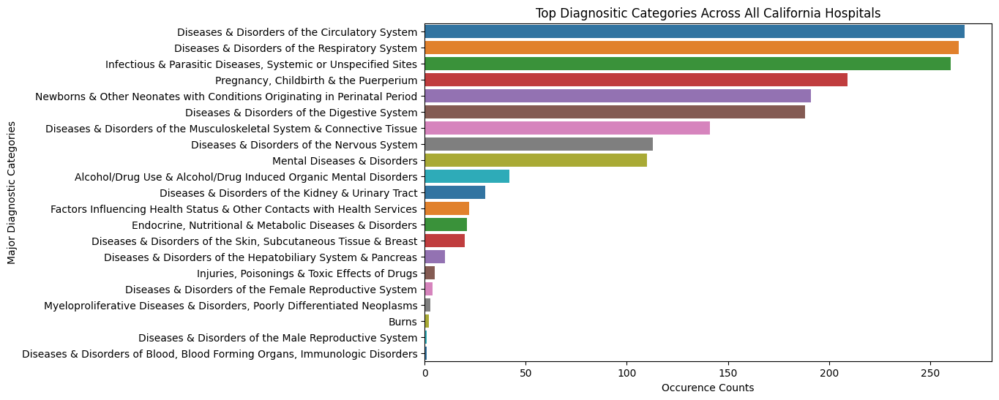

In [108]:
plt.figure(figsize=(10, 6))
sns.barplot(x=mdc_counts.values, y=mdc_counts.index, palette='tab10')
plt.title('Top Diagnositic Categories Across All California Hospitals')
plt.xlabel('Occurence Counts')
plt.ylabel('Major Diagnostic Categories')
plt.show()

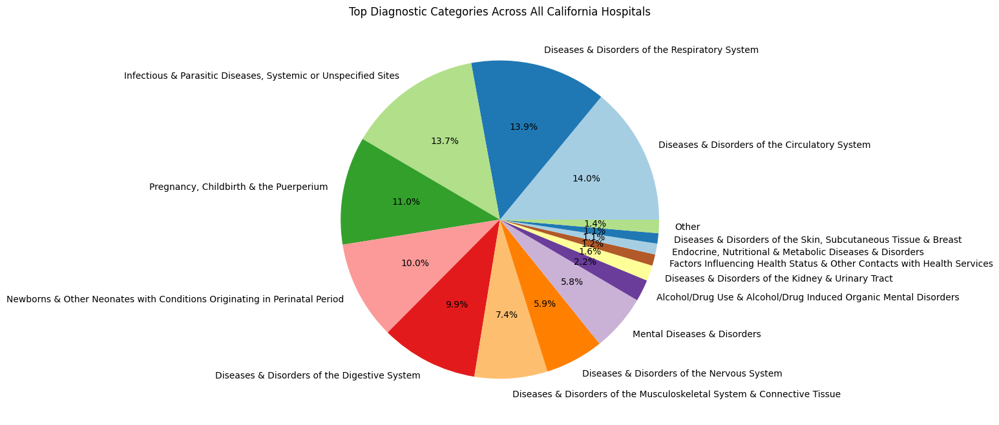

In [109]:
# calculate total counts and percentage for each category
total_count = mdc_counts.sum()
percentages = mdc_counts / total_count * 100

# identify categories with less than 1%
small_categories = percentages[percentages < 1]
large_categories = percentages[percentages >= 1]

# create new series for large categories and add 'Other' category
final_counts = large_categories.copy()
final_counts['Other'] = small_categories.sum()

labels = final_counts.index

# plot pie chart
plt.figure(figsize=(10, 8))
plt.pie(final_counts, labels=labels, autopct='%1.1f%%', colors=sns.color_palette('Paired', n_colors=len(final_counts)))
plt.title('Top Diagnostic Categories Across All California Hospitals')
plt.show()

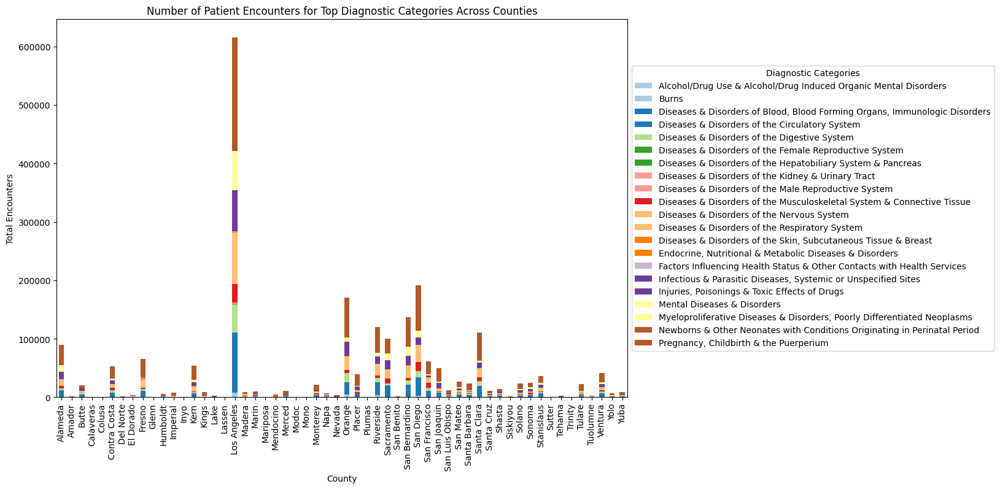

In [110]:
mdc_by_county = df.groupby(['COUNTY_NAME', 'MDC_DESC'])['DXPatCount'].sum().unstack().fillna(0)
mdc_by_county.plot(kind='bar', stacked=True, figsize=(12, 8), cmap='Paired')
plt.title('Number of Patient Encounters for Top Diagnostic Categories Across Counties')
plt.xlabel('County')
plt.ylabel('Total Encounters')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Diagnostic Categories')
plt.show()

C:\Users\nhumb\AppData\Local\Temp\ipykernel_34144\3041071244.py:5: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



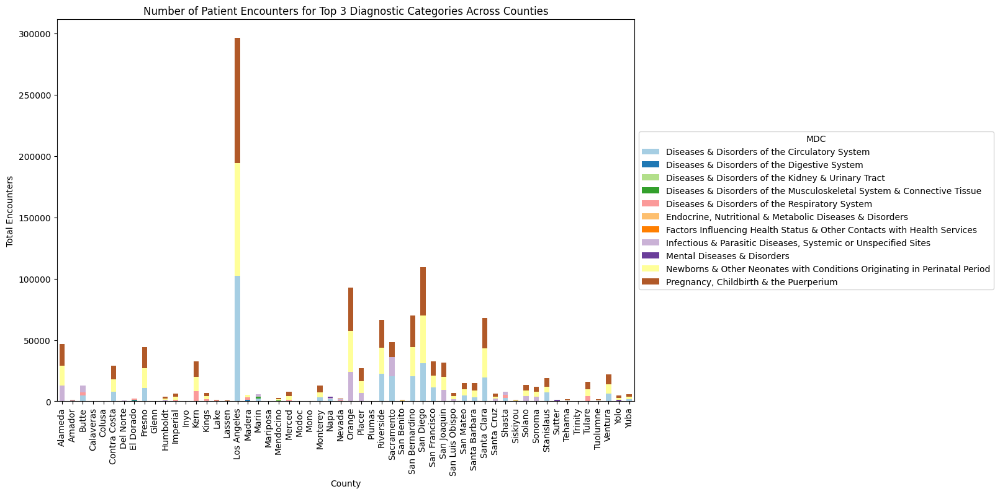

In [111]:
# group by county and MDC, summing DXPatCount
mdc_by_county = df.groupby(['COUNTY_NAME', 'MDC_DESC'])['DXPatCount'].sum().reset_index()

# get top 3 MDC_DESC per county
top_3_mdc = mdc_by_county.groupby('COUNTY_NAME').apply(lambda x: x.nlargest(3, 'DXPatCount')).reset_index(drop=True)

# pivot the data for plotting
mdc_by_county_pivot = top_3_mdc.pivot(index='COUNTY_NAME', columns='MDC_DESC', values='DXPatCount').fillna(0)

# plot
mdc_by_county_pivot.plot(kind='bar', stacked=True, figsize=(12, 8), cmap='Paired')
plt.title('Number of Patient Encounters for Top 3 Diagnostic Categories Across Counties')
plt.xlabel('County')
plt.ylabel('Total Encounters')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), title='MDC')
plt.show()


C:\Users\nhumb\AppData\Local\Temp\ipykernel_34144\3192577820.py:6: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




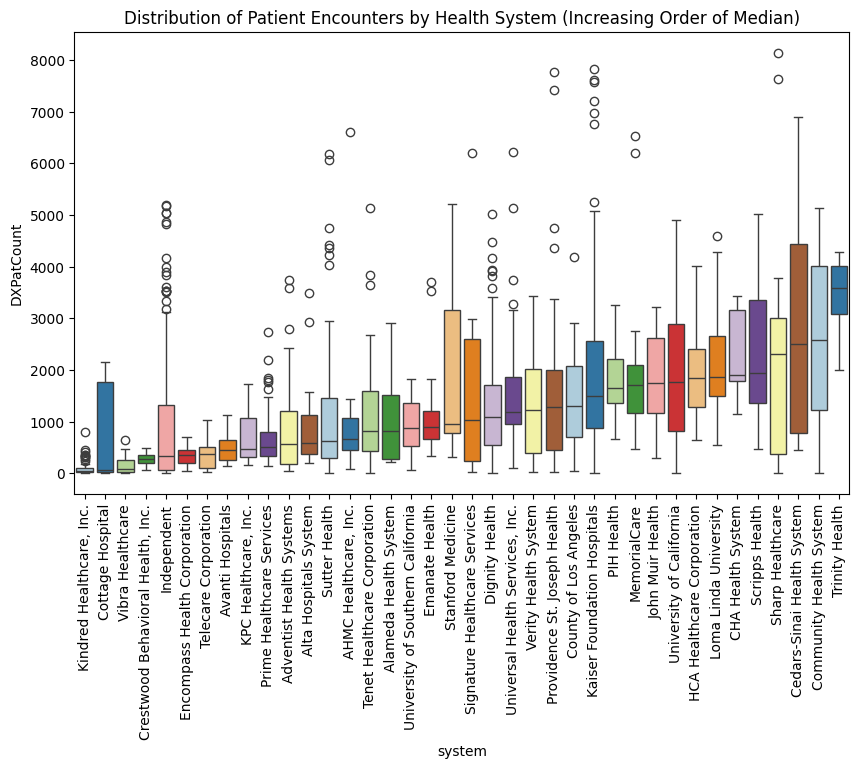

In [112]:
# calculate the median DXPatCount for each system and sort them in increasing order
sorted_systems = df.groupby('system')['DXPatCount'].median().sort_values().index

# plot the boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(x='system', y='DXPatCount', data=df, palette='Paired', order=sorted_systems)
plt.xticks(rotation=90)
plt.title('Distribution of Patient Encounters by Health System (Increasing Order of Median)')
plt.show()


C:\Users\nhumb\AppData\Local\Temp\ipykernel_34144\198252000.py:5: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\nhumb\AppData\Local\Temp\ipykernel_34144\198252000.py:16: UserWarning:

Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.



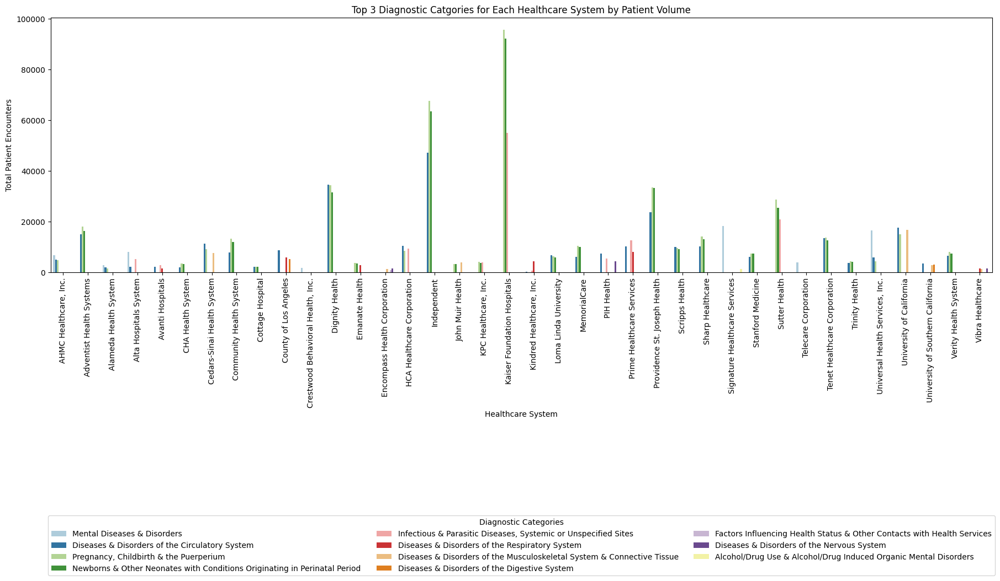

In [113]:
# group by system and MDC, summing DXPatCount
system_influence = df.groupby(['system', 'MDC_DESC'])['DXPatCount'].sum().reset_index()

# get top 3 MDC per healthcare system
top_3_mdc = system_influence.groupby('system').apply(lambda x: x.nlargest(3, 'DXPatCount')).reset_index(drop=True)

# plot
plt.figure(figsize=(22, 6))
sns.barplot(x='system', y='DXPatCount', hue='MDC_DESC', data=top_3_mdc, palette='Paired')

plt.title('Top 3 Diagnostic Catgories for Each Healthcare System by Patient Volume')
plt.xticks(rotation=90)
plt.xlabel('Healthcare System')
plt.ylabel('Total Patient Encounters')
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.94), ncol=3, title='Diagnostic Categories')
plt.tight_layout()
plt.show()

C:\Users\nhumb\AppData\Local\Temp\ipykernel_34144\2989558695.py:3: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



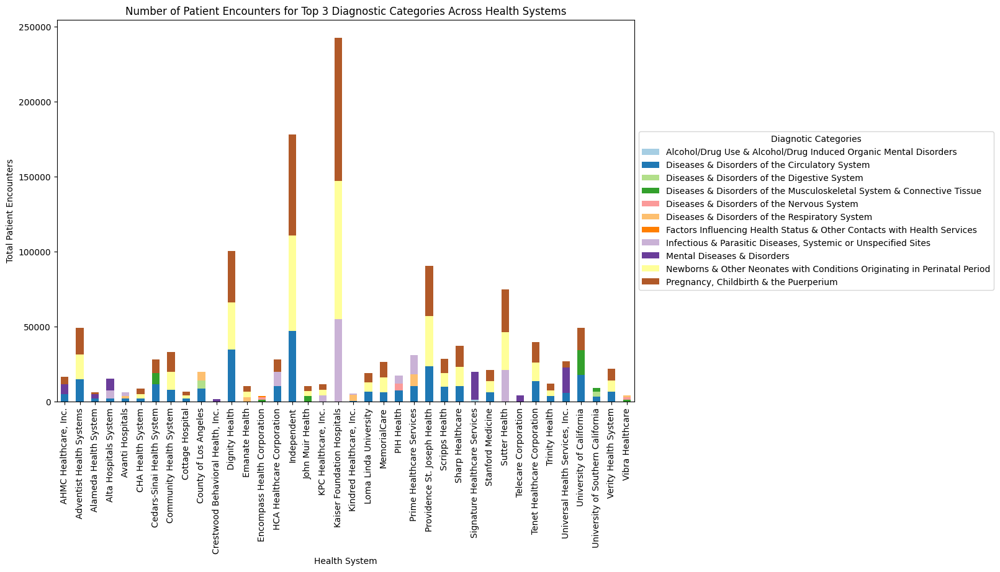

In [114]:
mdc_by_system = df.groupby(['system', 'MDC_DESC'])['DXPatCount'].sum().reset_index()

top_3_mdc = mdc_by_system.groupby('system').apply(lambda x: x.nlargest(3, 'DXPatCount')).reset_index(drop=True)

mdc_by_county_pivot = top_3_mdc.pivot(index='system', columns='MDC_DESC', values='DXPatCount').fillna(0)

mdc_by_county_pivot.plot(kind='bar', stacked=True, figsize=(12, 8), cmap='Paired')
plt.title('Number of Patient Encounters for Top 3 Diagnostic Categories Across Health Systems')
plt.xlabel('Health System')
plt.ylabel('Total Patient Encounters')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Diagnotic Categories')
plt.show()

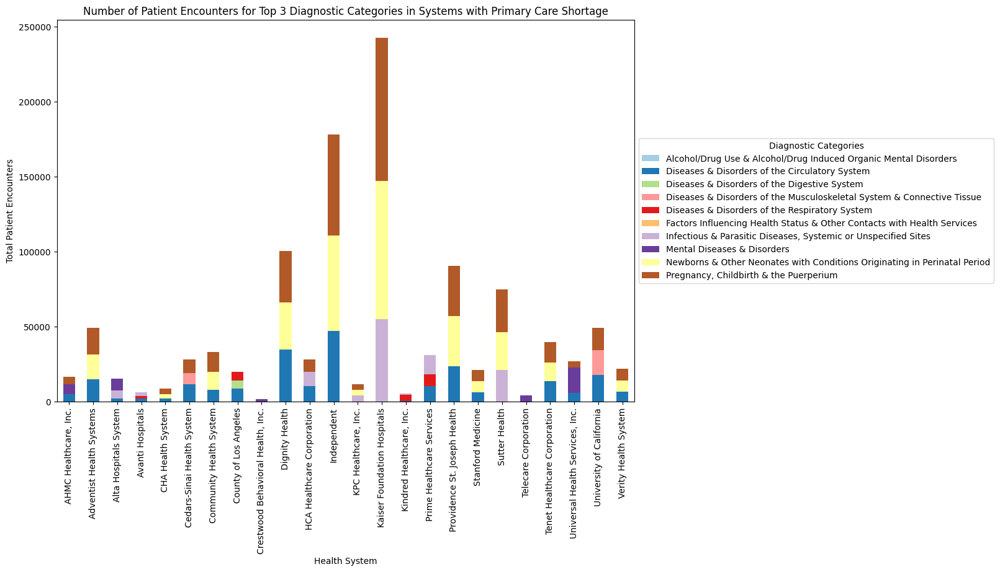

In [115]:
# filter the systems that have a primary care shortage
systems_with_shortage = df[df['PrimaryCareShortageArea'] == 'Yes']['system'].unique()

top_3_mdc_with_shortage = top_3_mdc[top_3_mdc['system'].isin(systems_with_shortage)]

mdc_with_shortage_pivot = top_3_mdc_with_shortage.pivot(index='system', columns='MDC_DESC', values='DXPatCount').fillna(0)

mdc_with_shortage_pivot.plot(kind='bar', stacked=True, figsize=(12, 8), cmap='Paired')
plt.title('Number of Patient Encounters for Top 3 Diagnostic Categories in Systems with Primary Care Shortage')
plt.xlabel('Health System')
plt.ylabel('Total Patient Encounters')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Diagnostic Categories')
plt.show()


In [116]:
df.head(2)

,oshpd_id9,FacilityName,MDC_DESC,DXPatCount,count,COUNTY_NAME,PrimaryCareShortageArea,MentalHealthShortageArea,system,Specialist
_id,,,,,,,,,,
1,106010735,Alameda Hospital,"Infectious & Parasitic Diseases, Systemic or U...",416,1,Alameda,No,No,Alameda Health System,Infectious Disease Specialist
2,106010735,Alameda Hospital,Diseases & Disorders of the Respiratory System,296,2,Alameda,No,No,Alameda Health System,Pulmonologist


In [117]:
new = df[df['PrimaryCareShortageArea'] == 'Yes']

new[['FacilityName', 'MDC_DESC', 'DXPatCount', 'COUNTY_NAME', 'system']]

,FacilityName,MDC_DESC,DXPatCount,COUNTY_NAME,system
_id,,,,,
75,Sutter Amador Hospital,"Infectious & Parasitic Diseases, Systemic or U...",465,Amador,Sutter Health
76,Sutter Amador Hospital,"Pregnancy, Childbirth & the Puerperium",305,Amador,Sutter Health
77,Sutter Amador Hospital,Diseases & Disorders of the Respiratory System,296,Amador,Sutter Health
78,Sutter Amador Hospital,Newborns & Other Neonates with Conditions Orig...,293,Amador,Sutter Health
79,Sutter Amador Hospital,Diseases & Disorders of the Digestive System,220,Amador,Sutter Health
...,...,...,...,...,...
1900,Adventist Health and Rideout,Diseases & Disorders of the Circulatory System,1963,Yuba,Adventist Health Systems
1901,Adventist Health and Rideout,"Pregnancy, Childbirth & the Puerperium",1925,Yuba,Adventist Health Systems
1902,Adventist Health and Rideout,Newborns & Other Neonates with Conditions Orig...,1900,Yuba,Adventist Health Systems


C:\Users\nhumb\AppData\Local\Temp\ipykernel_34144\3164710711.py:9: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




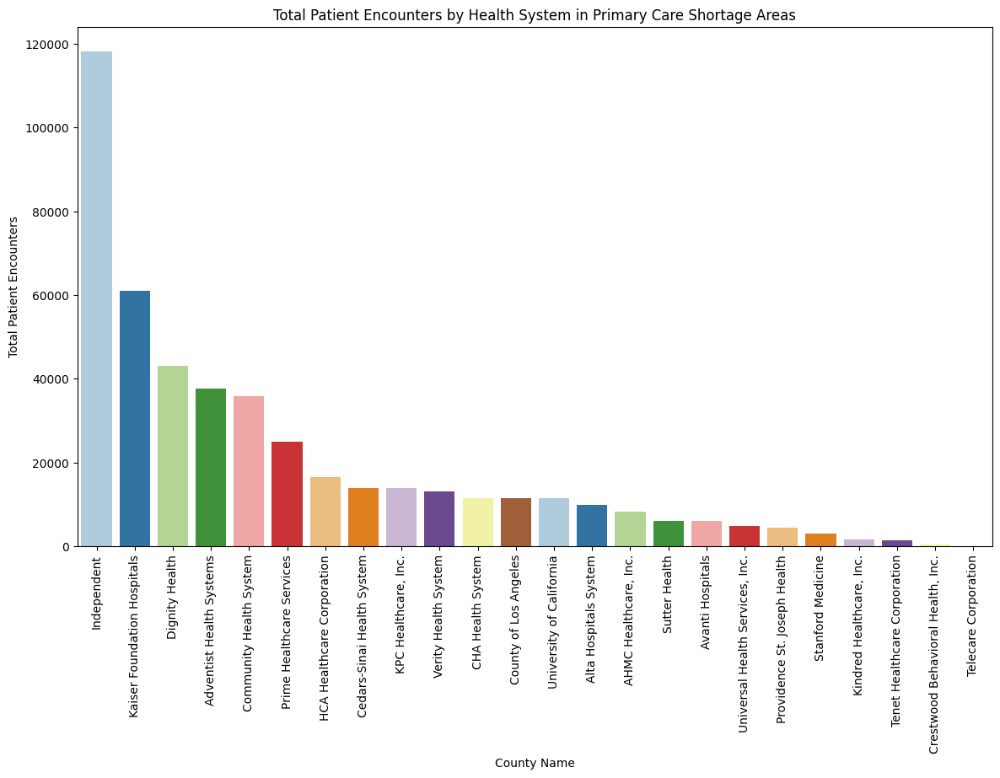

In [118]:
# group by FacilityName and sum DXPatCount
facility_summary = new.groupby('system')['DXPatCount'].sum().reset_index()

# sort by patient counts in descending order
facility_summary_sorted = facility_summary.sort_values(by='DXPatCount', ascending=False)

# plot
plt.figure(figsize=(14, 8))
sns.barplot(x='system', y='DXPatCount', data=facility_summary_sorted, palette ='Paired')

plt.xticks(rotation=90)
plt.title('Total Patient Encounters by Health System in Primary Care Shortage Areas')
plt.xlabel('County Name')
plt.ylabel('Total Patient Encounters')
plt.show()

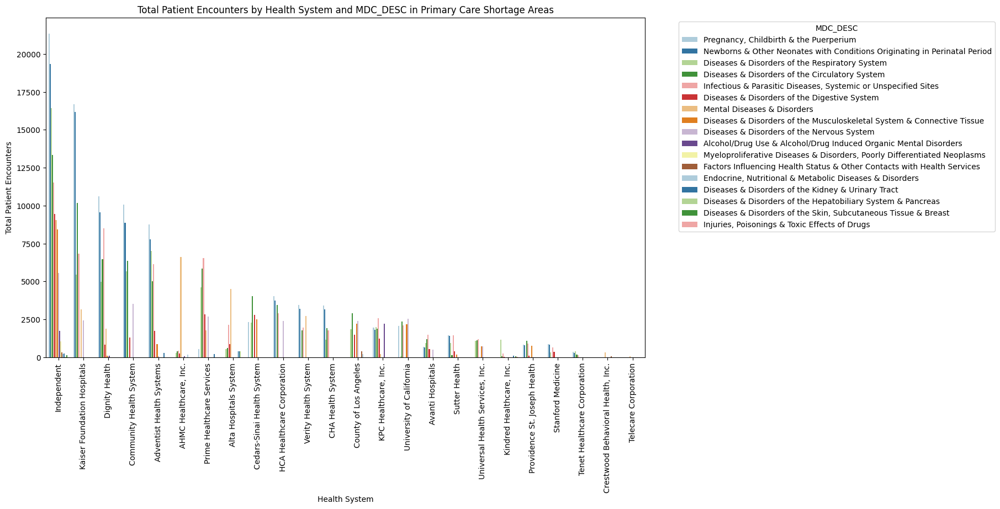

In [119]:
facility_summary = new.groupby(['system', 'MDC_DESC'])['DXPatCount'].sum().reset_index()

facility_summary_sorted = facility_summary.sort_values(by='DXPatCount', ascending=False)

plt.figure(figsize=(14, 8))
sns.barplot(x='system', y='DXPatCount', hue='MDC_DESC', data=facility_summary_sorted, palette='Paired')
plt.xticks(rotation=90)
plt.title('Total Patient Encounters by Health System and MDC_DESC in Primary Care Shortage Areas')
plt.xlabel('Health System')
plt.ylabel('Total Patient Encounters')
plt.legend(title='MDC_DESC', bbox_to_anchor=(1.05, 1), loc='upper left')  # Move legend outside the plot
plt.show()


In [120]:
df.head(2)

,oshpd_id9,FacilityName,MDC_DESC,DXPatCount,count,COUNTY_NAME,PrimaryCareShortageArea,MentalHealthShortageArea,system,Specialist
_id,,,,,,,,,,
1,106010735,Alameda Hospital,"Infectious & Parasitic Diseases, Systemic or U...",416,1,Alameda,No,No,Alameda Health System,Infectious Disease Specialist
2,106010735,Alameda Hospital,Diseases & Disorders of the Respiratory System,296,2,Alameda,No,No,Alameda Health System,Pulmonologist


In [121]:
# filter the df for hospitals with a need for sychiatrist specialist and in a mental health shortage area
psychiatrist_mh_shortage_df = df[(df['Specialist'] == 'Psychiatrist') & (df['MentalHealthShortageArea'] == 'Yes')]

# display df
psychiatrist_mh_shortage_df.head()

,oshpd_id9,FacilityName,MDC_DESC,DXPatCount,count,COUNTY_NAME,PrimaryCareShortageArea,MentalHealthShortageArea,system,Specialist
_id,,,,,,,,,,
95,106044006,Butte County Mental Health Services,Mental Diseases & Disorders,326,1,Butte,No,Yes,Independent,Psychiatrist
96,106044006,Butte County Mental Health Services,Alcohol/Drug Use & Alcohol/Drug Induced Organi...,18,2,Butte,No,Yes,Independent,Psychiatrist
197,106104089,Exodus PHF Fresno,Mental Diseases & Disorders,178,1,Fresno,Yes,Yes,Independent,Psychiatrist
198,106105125,Central Star PHF,Mental Diseases & Disorders,603,1,Fresno,Yes,Yes,Independent,Psychiatrist
220,106124004,Sempervirens PHF,Mental Diseases & Disorders,367,1,Humboldt,Yes,Yes,Independent,Psychiatrist


C:\Users\nhumb\AppData\Local\Temp\ipykernel_34144\75605622.py:6: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




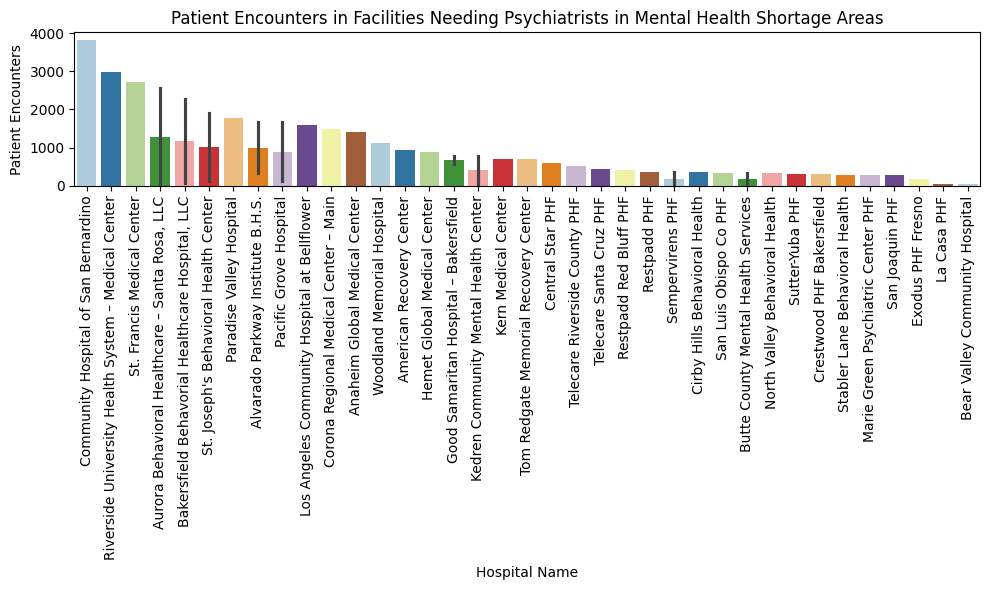

In [122]:
# sort the filtered df by patient count in ascending order
psychiatrist_mh_shortage_df_sorted = psychiatrist_mh_shortage_df.sort_values(by='DXPatCount', ascending=False)

# plot
plt.figure(figsize=(10, 6))
sns.barplot(x='FacilityName', y='DXPatCount', data=psychiatrist_mh_shortage_df_sorted, palette='Paired')

plt.xticks(rotation=90)
plt.title('Patient Encounters in Facilities Needing Psychiatrists in Mental Health Shortage Areas')
plt.xlabel('Hospital Name')
plt.ylabel('Patient Encounters')
plt.tight_layout()

plt.show()

In [123]:
# filter the df for hospitals with either an Internal Medicine or Emergency Medicine specialist
# and in a primary care shortage area
primary_care_shortage_df = df[(df['Specialist'].isin(['Internal Medicine Physician', 'Emergency Medicine Physician'])) & 
                              (df['PrimaryCareShortageArea'] == 'Yes')]

primary_care_shortage_df


,oshpd_id9,FacilityName,MDC_DESC,DXPatCount,count,COUNTY_NAME,PrimaryCareShortageArea,MentalHealthShortageArea,system,Specialist
_id,,,,,,,,,,
199,106110889,Glenn Medical Center,Factors Influencing Health Status & Other Cont...,98,1,Glenn,Yes,Yes,Independent,Internal Medicine Physician
291,106154160,Crestwood PHF Bakersfield,Factors Influencing Health Status & Other Cont...,73,2,Kern,Yes,Yes,"Crestwood Behavioral Health, Inc.",Internal Medicine Physician
359,106190137,Casa Colina Hospital,Factors Influencing Health Status & Other Cont...,206,3,Los Angeles,Yes,Yes,Independent,Internal Medicine Physician
742,106191306,Los Angeles County/Rancho Los Amigos National ...,Factors Influencing Health Status & Other Cont...,396,3,Los Angeles,Yes,Yes,County of Los Angeles,Internal Medicine Physician
1059,106320859,Eastern Plumas Hospital – Portola Campus,Factors Influencing Health Status & Other Cont...,13,5,Plumas,Yes,Yes,Independent,Internal Medicine Physician
1117,106332172,Kindred Hospital – Riverside,"Injuries, Poisonings & Toxic Effects of Drugs",14,4,Riverside,Yes,No,"Kindred Healthcare, Inc.",Emergency Medicine Physician


In [124]:
# rename the columns
primary_care_shortage_df = primary_care_shortage_df.rename(columns={
    'FacilityName': 'Hospital Name',
    'COUNTY_NAME': 'County',
    'PrimaryCareShortageArea': 'Primary Care Shortage Area',
    'Specialist': 'Physician Needed'
})

# display the df to check the new column names
primary_care_shortage_df[['Hospital Name', 'County', 'Primary Care Shortage Area', 'Physician Needed']]


,Hospital Name,County,Primary Care Shortage Area,Physician Needed
_id,,,,
199,Glenn Medical Center,Glenn,Yes,Internal Medicine Physician
291,Crestwood PHF Bakersfield,Kern,Yes,Internal Medicine Physician
359,Casa Colina Hospital,Los Angeles,Yes,Internal Medicine Physician
742,Los Angeles County/Rancho Los Amigos National ...,Los Angeles,Yes,Internal Medicine Physician
1059,Eastern Plumas Hospital – Portola Campus,Plumas,Yes,Internal Medicine Physician
1117,Kindred Hospital – Riverside,Riverside,Yes,Emergency Medicine Physician


In [125]:
def county_FIPS_dict(dataframe):
    unique_county = dataframe['COUNTY_NAME'].unique()
    
    county_dict = {disease: 'Fill' for disease in unique_county}
    
    return county_dict

In [126]:
county_FIPS_dict(df)

{'Alameda': 'Fill',
 'Amador': 'Fill',
 'Butte': 'Fill',
 'Calaveras': 'Fill',
 'Colusa': 'Fill',
 'Contra Costa': 'Fill',
 'Del Norte': 'Fill',
 'El Dorado': 'Fill',
 'Fresno': 'Fill',
 'Glenn': 'Fill',
 'Humboldt': 'Fill',
 'Imperial': 'Fill',
 'Inyo': 'Fill',
 'Kern': 'Fill',
 'Kings': 'Fill',
 'Lake': 'Fill',
 'Lassen': 'Fill',
 'Los Angeles': 'Fill',
 'Madera': 'Fill',
 'Marin': 'Fill',
 'Mariposa': 'Fill',
 'Mendocino': 'Fill',
 'Merced': 'Fill',
 'Modoc': 'Fill',
 'Mono': 'Fill',
 'Monterey': 'Fill',
 'Napa': 'Fill',
 'Nevada': 'Fill',
 'Orange': 'Fill',
 'Placer': 'Fill',
 'Plumas': 'Fill',
 'Riverside': 'Fill',
 'Sacramento': 'Fill',
 'San Benito': 'Fill',
 'San Bernardino': 'Fill',
 'San Diego': 'Fill',
 'San Francisco': 'Fill',
 'San Joaquin': 'Fill',
 'San Luis Obispo': 'Fill',
 'San Mateo': 'Fill',
 'Santa Barbara': 'Fill',
 'Santa Clara': 'Fill',
 'Santa Cruz': 'Fill',
 'Shasta': 'Fill',
 'Siskiyou': 'Fill',
 'Solano': 'Fill',
 'Sonoma': 'Fill',
 'Stanislaus': 'Fill',
 'S

In [127]:
# create the dictionary with FIPs codes
FIPS_dict = {'Alameda': '06001',
 'Amador': '06003',
 'Butte': '06007',
 'Calaveras': '06009',
 'Colusa': '06011',
 'Contra Costa': '06013',
 'Del Norte': '06015',
 'El Dorado': '06017',
 'Fresno': '06019',
 'Glenn': '06021',
 'Humboldt': '06023',
 'Imperial': '06025',
 'Inyo': '06027',
 'Kern': '06029',
 'Kings': '06031',
 'Lake': '06033',
 'Lassen': '06035',
 'Los Angeles': '06037',
 'Madera': '06039',
 'Marin': '06041',
 'Mariposa': '06043',
 'Mendocino': '06045',
 'Merced': '06047',
 'Modoc': '06049',
 'Mono': '06051',
 'Monterey': '06053',
 'Napa': '06055',
 'Nevada': '06057',
 'Orange': '06059',
 'Placer': '06061',
 'Plumas': '06063',
 'Riverside': '06065',
 'Sacramento': '06067',
 'San Benito': '06069',
 'San Bernardino': '06071',
 'San Diego': '06073',
 'San Francisco': '06075',
 'San Joaquin': '06077',
 'San Luis Obispo': '06079',
 'San Mateo': '06081',
 'Santa Barbara': '06083',
 'Santa Clara': '06085',
 'Santa Cruz': '06087',
 'Shasta': '06089',
 'Siskiyou': '06093',
 'Solano': '06095',
 'Sonoma': '06097',
 'Stanislaus': '06099',
 'Sutter': '06101',
 'Tehama': '06103',
 'Trinity': '06105',
 'Tulare': '06107',
 'Tuolumne': '06109',
 'Ventura': '06111',
 'Yolo': '06113',
 'Yuba': '06115'}

In [128]:
df['County_Code'] = df['COUNTY_NAME'].map(FIPS_dict)

In [129]:
df.head(2)

,oshpd_id9,FacilityName,MDC_DESC,DXPatCount,count,COUNTY_NAME,PrimaryCareShortageArea,MentalHealthShortageArea,system,Specialist,County_Code
_id,,,,,,,,,,,
1,106010735,Alameda Hospital,"Infectious & Parasitic Diseases, Systemic or U...",416,1,Alameda,No,No,Alameda Health System,Infectious Disease Specialist,06001
2,106010735,Alameda Hospital,Diseases & Disorders of the Respiratory System,296,2,Alameda,No,No,Alameda Health System,Pulmonologist,06001


In [130]:
topMDC = df[df['count'] == "1"]

In [131]:
topMDC.head()

,oshpd_id9,FacilityName,MDC_DESC,DXPatCount,count,COUNTY_NAME,PrimaryCareShortageArea,MentalHealthShortageArea,system,Specialist,County_Code
_id,,,,,,,,,,,
1,106010735,Alameda Hospital,"Infectious & Parasitic Diseases, Systemic or U...",416,1,Alameda,No,No,Alameda Health System,Infectious Disease Specialist,06001
6,106010739,Alta Bates Summit Medical Center – Alta Bates ...,"Pregnancy, Childbirth & the Puerperium",4758,1,Alameda,No,No,Sutter Health,Obstetrician,06001
11,106010776,UC San Francisco Benioff Children's Hospital O...,Diseases & Disorders of the Digestive System,919,1,Alameda,No,No,University of California,Gastroenterologist,06001
16,106010844,Alta Bates Summit Medical Center – Herrick Campus,Mental Diseases & Disorders,2198,1,Alameda,No,No,Sutter Health,Psychiatrist,06001
19,106010846,Highland Hospital,Mental Diseases & Disorders,2902,1,Alameda,No,No,Alameda Health System,Psychiatrist,06001


In [132]:
county_summary = topMDC.groupby(['County_Code', 'COUNTY_NAME']).agg({'DXPatCount': 'sum'}).reset_index()

In [133]:
DXPatTotaldf = pd.DataFrame(county_summary)

In [134]:
DXPatTotaldf.head()

,County_Code,COUNTY_NAME,DXPatCount
0,06001,Alameda,34383
1,06003,Amador,465
2,06007,Butte,6844
3,06009,Calaveras,169
4,06011,Colusa,263


In [135]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

counties["features"][0]

{'type': 'Feature',
 'properties': {'GEO_ID': '0500000US01001',
  'STATE': '01',
  'COUNTY': '001',
  'NAME': 'Autauga',
  'LSAD': 'County',
  'CENSUSAREA': 594.436},
 'geometry': {'type': 'Polygon',
  'coordinates': [[[-86.496774, 32.344437],
    [-86.717897, 32.402814],
    [-86.814912, 32.340803],
    [-86.890581, 32.502974],
    [-86.917595, 32.664169],
    [-86.71339, 32.661732],
    [-86.714219, 32.705694],
    [-86.413116, 32.707386],
    [-86.411172, 32.409937],
    [-86.496774, 32.344437]]]},
 'id': '01001'}

In [136]:
fig = px.choropleth(DXPatTotaldf, geojson=counties, locations='County_Code', color='DXPatCount',
                    color_continuous_scale="GnBu",
                    range_color=(0, 62000),
                    scope="usa",
                    labels={'DXPatCount':'Patient Counts'},
                    hover_name='COUNTY_NAME'
                   )

fig.update_layout(
    title_text="Patient Counts by County",
    title_x=0.5,  
    margin={"r":0,"t":50,"l":0,"b":0}  
)
fig.show()


In [137]:
physician_shortage_df = df[df['PrimaryCareShortageArea'] == 'Yes']

county_shortage_counts = physician_shortage_df.groupby(['COUNTY_NAME', 'County_Code']).size().reset_index(name='HospitalCount')

county_shortage_counts = county_shortage_counts.sort_values(by='HospitalCount', ascending=False)

print(county_shortage_counts)

       COUNTY_NAME County_Code  HospitalCount
15     Los Angeles       06037            123
27  San Bernardino       06071             42
25       Riverside       06065             24
11            Kern       06029             22
6           Fresno       06019             22
23          Orange       06059             20
29     San Joaquin       06077             19
8         Humboldt       06023             18
38          Tulare       06107             15
18       Mendocino       06045             15
19          Merced       06047             11
13            Lake       06033             10
21        Monterey       06053             10
22          Nevada       06057             10
16          Madera       06039             10
1            Butte       06007             10
33        Siskiyou       06093             10
9         Imperial       06025             10
24          Plumas       06063              6
36          Tehama       06103              6
5        El Dorado       06017    

In [138]:
fig = px.choropleth(county_shortage_counts, geojson=counties, locations='County_Code', color='HospitalCount',
                    color_continuous_scale="GnBu", 
                    scope="usa",
                    range_color=(0, 100),
                    labels={'HospitalCount':'Number of Hospitals with Shortages'},
                    hover_name='COUNTY_NAME'
                   )

fig.update_layout(
    title_text="Number of Hospitals with Physician Shortages",
    title_x=0.5,
    margin={"r":0,"t":30,"l":0,"b":0}
)

fig.show()

In [139]:
# group by 'system' and count the number of hospitals in each health system
health_system_shortage_counts = physician_shortage_df.groupby('system').size().reset_index(name='HospitalCount')

# sort the result by the number of hospitals in descending order
health_system_shortage_counts = health_system_shortage_counts.sort_values(by='HospitalCount', ascending=False)

# display the health systems with the most hospitals with physician shortages
print(health_system_shortage_counts)


                               system  HospitalCount
11                        Independent            201
1            Adventist Health Systems             65
9                      Dignity Health             38
15          Prime Healthcare Services             25
12               KPC Healthcare, Inc.             20
13        Kaiser Foundation Hospitals             20
18                      Sutter Health             20
14           Kindred Healthcare, Inc.             19
2               Alta Hospitals System             11
3                    Avanti Hospitals             10
22           University of California             10
6             Community Health System             10
7               County of Los Angeles             10
16       Providence St. Joseph Health             10
0               AHMC Healthcare, Inc.              7
5          Cedars-Sinai Health System              5
4                   CHA Health System              5
10         HCA Healthcare Corporation         